In [3]:
import random
from torch.utils.data import DataLoader
from torchvision import datasets, transforms as T
import torchvision.transforms.functional as TF
from PIL import Image, ImageDraw, ImageFont
import numpy as np
import cv2
import os
import sys
import torch
import string

In [4]:
watermarks_root = "./transparent_logos" # png
clean_images_root = "./clean_target_images" # jpg
font_root = "./ttf_fonts" # ttf
banner_ads_root = "./ad_banners" # jpg

In [ ]:
clean_files = [os.path.join(clean_images_root, file) for file in os.listdir(clean_images_root)]
clean_files

In [ ]:
font_files = [os.path.join(font_root, file) for file in os.listdir(font_root) if file.lower().endswith('.ttf')]
font_files

In [ ]:
watermarks = []
for root, _, files in os.walk(watermarks_root, topdown=False):
    watermarks.extend(os.path.join(root, f) for f in files if f.endswith('png'))
watermarks

In [ ]:
banner_ads = []
for root, dirs, files in os.walk(banner_ads_root, topdown=False):
    banner_ads.extend(os.path.join(root, f) for f in files if f.endswith('jpg'))
banner_ads

In [29]:
def get_random_string():
    N = random.choice(range(4,8))
    M = random.choice(range(2,3))
    letter_set = string.ascii_letters + string.digits + string.punctuation
    return ' '.join([''.join(random.choices(letter_set, k=N)) for _ in range(M)])

def add_random_text(img, mask, wm_g):
    img_width, img_height = img.size
    font_size = random.randint(int(img_height/10), int(img_height/7))
    font = ImageFont.truetype(random.choice(font_files), font_size)    
    
    text_alpha = random.choices(population=[random.randint(80,180), 255], weights=[0.8,0.2],k=1)[0]  
    text_color = random.choices(population=[(0,0,0), (255,255,255)], weights=[0.2,0.8],k=1)[0] 
    
    text_x_pos, text_y_pos = random.randint(0,int(img_width*0.66)), random.randint(0,img_height-font_size)
    
    txt = Image.new('RGBA', img.size, (0,0,0,0))
    d = ImageDraw.Draw(txt)    
    d.text((text_x_pos, text_y_pos), get_random_string(), fill=(*text_color, text_alpha), font=font)
    mask *= 1-(np.array(txt)[:,:,-1]/255)
    
    wm_g = Image.alpha_composite(wm_g, txt)
    return Image.alpha_composite(img, txt), mask, Image.alpha_composite(wm_g, txt)

def add_random_watermark(img, mask, wm_g):
    img_width, img_height = img.size
    wm_file = random.choice(watermarks)
    wm = Image.open(wm_file).convert('RGBA')
    
    alpha = random.choices(population=[random.randint(80,180), 255], weights=[0.8,0.2],k=1)[0]  
    rotate_angle = random.randint(0,360)
    aspect_ratio = wm.size[0] / wm.size[1]
    wm_height = int(random.uniform(img_height//6, img_height//2))
    wm_width = int(wm_height/aspect_ratio)
    wm = wm.resize((wm_width, wm_height)).rotate(rotate_angle, expand = True)
    wm_width, wm_height = wm.size
    
    wm_x_pos, wm_y_pos = random.randint(0,img_width-wm_width), random.randint(0,img_height-wm_height)
       
    wm_alpha = wm.getchannel('A').point(lambda i: alpha if i>0 else 0)
    wm.putalpha(wm_alpha)
    
    wm_g.paste(wm, (wm_x_pos, wm_y_pos), wm)
    img.paste(wm, (wm_x_pos, wm_y_pos), wm)
    
    norm_alpha_complement = 1 - (np.array(wm_alpha)/255)
    mask[wm_y_pos:wm_y_pos+wm_height, wm_x_pos:wm_x_pos+wm_width] *= norm_alpha_complement
    
    return img, mask, wm_g
    
    
def add_random_ad_banner(img, mask, wm_g):
    img_width, img_height = img.size
    banner_size = random.randint(int(img_height/10), int(img_height/5))    
    banner_alpha = random.choices(population=[random.randint(80,180), 255], weights=[0.8,0.2],k=1)[0]  
    banner_file = random.choice(banner_ads)
    banner = Image.open(banner_file).convert('RGBA')
    
    banner_width, banner_height = banner.size    
    aspect_ratio = banner_width / banner_height
    banner_width, banner_height = img_width, int(img_width / aspect_ratio)    
    banner = banner.resize((banner_width, banner_height))
    
    crop_tuple = random.choice([(0,0,banner_width,banner_size),(0,banner_height-banner_size,banner_width,banner_height)])
    banner = banner.crop(crop_tuple)
    banner.putalpha(int(banner_alpha))
    
    banner_y_pos = random.choice([0, img_height-banner_size])
    img.paste(banner, (0, banner_y_pos, img_width, banner_y_pos+banner_size), banner)
    wm_g.paste(banner, (0, banner_y_pos, img_width, banner_y_pos+banner_size), banner)
    norm_alpha_complement = 1 - (np.array(banner_alpha)/255)
    mask[banner_y_pos:banner_y_pos+banner_size, 0:img_width] *= norm_alpha_complement
    
    return img, mask, wm_g


def hcat_pil(im1, im2, im3):
    dst = Image.new('RGBA', (im1.width + im2.width + im3.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    dst.paste(im3, (im2.width + im1.width, 0))
    return dst
    
# def add_random_color_stripe(img):
#     img_width, img_height = img.size
#     banner_size = random.randint(int(img_height/10), int(img_height/7))    
#     banner_alpha = random.choice([random.uniform(0.3, 0.7), 1,1,1,1])    
#     banner_color = [random.randint(0,255) for _ in range(3)]
    
#     img_y_pos = random.choice([0, img_height-banner_size])
    
#     banner = Image.new('RGBA', img.size, (255,255,255,0))
#     d = ImageDraw.Draw(banner)    
#     d.rectangle([(0,img_y_pos), (img_width, img_y_pos+banner_size)], fill=(*banner_color, int(255*text_alpha)))
#     return Image.alpha_composite(img, banner)

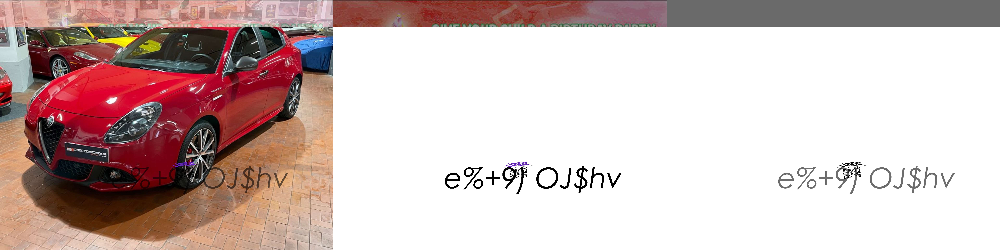

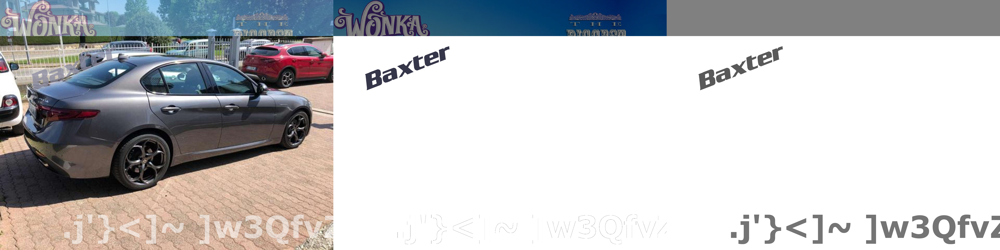

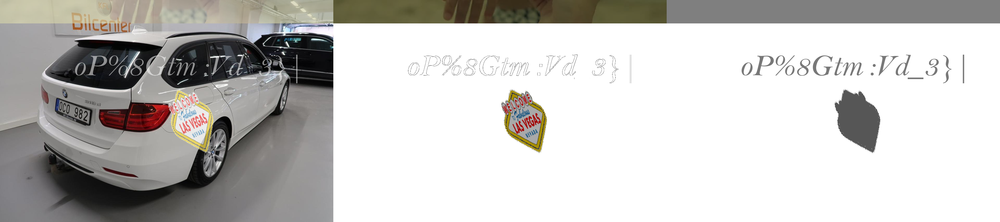

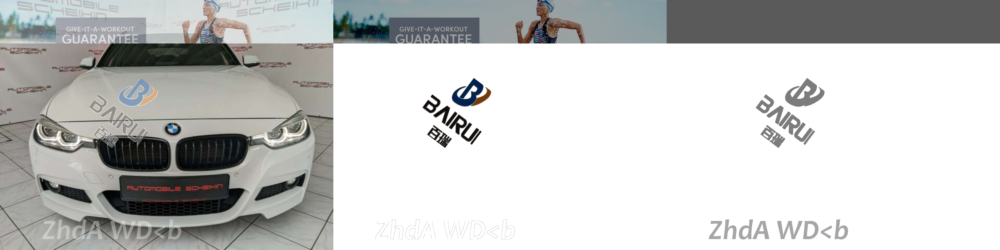

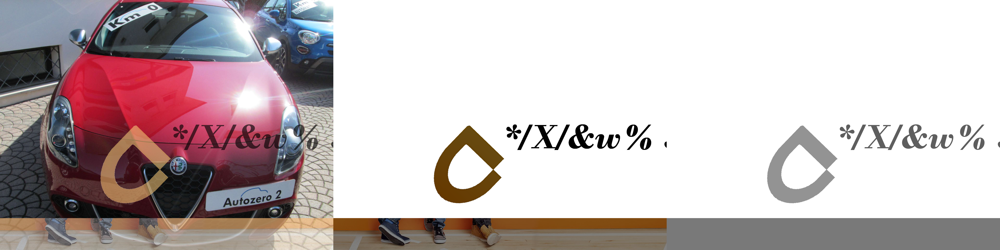

In [30]:
for clean in clean_files:
    img = Image.open(clean).convert("RGBA")
    wm = Image.new('RGBA', img.size, (0,0,0,0))
    mask = np.ones((img.size[1], img.size[0])) 
    img, mask, wm = add_random_watermark(img, mask, wm)
    img, mask, wm = add_random_ad_banner(img, mask, wm)
    img, mask, wm = add_random_text(img, mask, wm)
    wm.putalpha(wm.getchannel('A').point(lambda i: 255 if i>0 else 0))
    alpha = Image.fromarray(np.uint8(mask * 255), 'L'))
    display(hcat_pil(img, wm, alpha))    